# nathan's thoughts

I think this code has the most potential to be the best at making patches that cover the width of the entire epithelium layer.

## Whole Cell Gridding Code

This algorithm essentailly just looks at the outline of a cell as a "line" point by point

It then takes that "line" and creates squares normal to the contour on it

Then checks those against other squares for overlap and removes excessively overlapping ones


This currently just draws squares, but if that's possible it shouldn't be too complex to extract images from the defined squares

I think cv2.getPerspectiveTransform might be useful for that

This code largely hinges on the epithelium being/annotated in one continuous piece

In [1]:
import numpy as np
import cv2
import matplotlib.pyplot as plt


#Read image and threshold for mask:
#This basic method works best with already cropped cells
#I have another at the bottom that is slightly better for cells with backgrounds
image1=cv2.imread("Segmenting Code/h2114153  h&e_ROI_1 Epithelia.png")
image1_gray = cv2.cvtColor(image1, cv2.COLOR_BGR2GRAY)
_,whole_thresh=cv2.threshold(image1_gray,1,255,cv2.THRESH_BINARY)


## Finding contours

It is designed to take in a cell that has been seperated from the background. The mask/thresh should have clear lines for a contour to be drawn along

In [2]:
def find_largest_countour(binary_image):
    """Calulate the largest vector in a binary image-typically the outline"""
    contours, _=cv2.findContours(binary_image,cv2.RETR_EXTERNAL,cv2.CHAIN_APPROX_SIMPLE)
    return max(contours,key=cv2.contourArea)

In [3]:
def find_second_largest_countour(binary_image):
    """Calculate the second largest vector in binary image (should be the inner layer)"""
    contours, _ = cv2.findContours(binary_image, cv2.RETR_TREE, cv2.CHAIN_APPROX_SIMPLE)
    contours = sorted(contours, key=cv2.contourArea, reverse=True)
    return contours[1]

## Calculations

##### Contour normals

In [27]:
def calculate_contour_tangents(contour,smooting_size=5):
    """
    Calculate tangent vectors across the contour
    """
    #The normal vector is parallel to contour at a point and ensures the square goes in to the cell
    #Smoothing size is how many points before and after current to look back and find tangent

    #Reshape contour into (x,y) pairings
    points=contour.reshape(-1,2)
    n_points=len(points)
    tangents=np.zeros_like(points,dtype=float)

    for i in range(n_points):
        #get indices, % handles wraparound
        prev_idx=(i-smooting_size)%n_points
        next_idx=(i+smooting_size)%n_points
        tangent=points[next_idx]-points[prev_idx]

        tangents[i]=tangent

    return tangents

##### Square corners

# Modify some of the logic here so that it reaches out until it hits an inner contour point. From there it extends the corners outwards to form a square.

Can start from a single point, dont' find the tangent yet. I then find the closest point on inner contour, and then create a tangent that is that distance to the next point on the contour (may need some code here to figure out which point to choose that is next in line Can create normal vector from the vector from point to point and then create square off of that). Then create a square to that closest point on inner contour. Iterate all around.

Potential problems - it doesn't innately check just how off that normal vector is. The two closest points could be very far from each other, but because the tissue is so twisted it chooses an inner point that is not connected to the outer point, but is closer because the outer layer is so twisted and thick. Would be nice to be able to find regular tangent of the next few points of the outer contour point and then figure out the angle of the normal of that outer ocntour point and the normal vector I created to see if it varies wayyyyy too much. If it does, then iteratively rechoose the inner point until the angle is within acceptable bounds.

In [58]:
# Take one
def calculate_square_corners(point,tangent, inner_contour, square_size):
    """Calculate square corners so that top edge is touching the contour point"""
    unit_tangent = tangent / np.linalg.norm(tangent + 1e-10)
    inner_points = inner_contour.reshape(-1, 2)

    # Calculate normal vector and make sure it is pointing inwards towards the inner contour. If not then reverse it
    normal_vector = np.array([-unit_tangent[1], unit_tangent[0]])
    distances = np.linalg.norm(inner_points - point, axis = 1)
    min_dist_index = np.argmin(distances)
    closest_point = inner_points[min_dist_index]
    closest_vector = closest_point - point
    if np.dot(normal_vector, closest_vector) / (np.linalg.norm(normal_vector) * np.linalg.norm(closest_vector)) < 0.5:
        normal_vector = -normal_vector

    ####################################
    # Calculate closest point in inner contour array and make vector between the two.
    # Find the distance of that vector and make that the square width/height
    # Create square based on normal vector of tangent
    distance = distances[min_dist_index]
    half_size = distance/2
    unit_normal = normal_vector / np.linalg.norm(normal_vector + 1e-10)
    ###################################



    #Take point and extend from it in tangent and normal directions
    #Normalization allows for multiplication by square size
    corners=np.array([
        point+(unit_tangent*half_size),
        point-(unit_tangent*half_size),
        point-(unit_tangent*half_size)+(unit_normal*distance),
        point+(unit_tangent*half_size)+(unit_normal*distance)
    ])
    return corners

In [60]:
# Take two, only checks the closest point on the inner contour and then leaves it at that
def calculate_square_corners(point,tangent, inner_contour, square_size):
    """Calculate square corners so that top edge is touching the contour point"""
    inner_points = inner_contour.reshape(-1, 2)

    # Calculate normal vector and make sure it is pointing inwards towards the inner contour. If not then reverse it
    distances = np.linalg.norm(inner_points - point, axis = 1)
    min_dist_index = np.argmin(distances)
    closest_point = inner_points[min_dist_index]
    normal_vector = closest_point - point

    tangent_vector = np.array([-normal_vector[1], normal_vector[0]])
    unit_tangent = tangent_vector / np.linalg.norm(tangent_vector + 1e-10)

    ####################################
    # Calculate closest point in inner contour array and make vector between the two.
    # Find the distance of that vector and make that the square width/height
    # Create square based on normal vector of tangent
    distance = distances[min_dist_index]
    half_size = distance/2
    unit_normal = normal_vector / np.linalg.norm(normal_vector + 1e-10)
    ###################################



    #Take point and extend from it in tangent and normal directions
    #Normalization allows for multiplication by square size
    corners=np.array([
        point+(unit_tangent*half_size),
        point-(unit_tangent*half_size),
        point-(unit_tangent*half_size)+(unit_normal*distance),
        point+(unit_tangent*half_size)+(unit_normal*distance)
    ])
    return corners

In [ ]:
# Take two, only checks the closest point on the inner contour and then leaves it at that
def calculate_square_corners(point,tangent, inner_contour, square_size):
    """Calculate square corners so that top edge is touching the contour point"""
    inner_points = inner_contour.reshape(-1, 2)

    # Calculate normal vector and make sure it is pointing inwards towards the inner contour. If not then reverse it
    distances = np.linalg.norm(inner_points - point, axis = 1)
    min_dist_index = np.argmin(distances)
    closest_point = inner_points[min_dist_index]
    normal_vector = closest_point - point

    tangent_vector = np.array([-normal_vector[1], normal_vector[0]])
    unit_tangent = tangent_vector / np.linalg.norm(tangent_vector + 1e-10)

    ####################################
    # Calculate closest point in inner contour array and make vector between the two.
    # Find the distance of that vector and make that the square width/height
    # Create square based on normal vector of tangent
    distance = distances[min_dist_index]
    half_size = distance/2
    unit_normal = normal_vector / np.linalg.norm(normal_vector + 1e-10)
    ###################################



    #Take point and extend from it in tangent and normal directions
    #Normalization allows for multiplication by square size
    corners=np.array([
        point+(unit_tangent*half_size),
        point-(unit_tangent*half_size),
        point-(unit_tangent*half_size)+(unit_normal*distance),
        point+(unit_tangent*half_size)+(unit_normal*distance)
    ])
    return corners

##### Overlap area

In [43]:
def calculate_overlap_area(square1,square2):
    """
    Calculate approx overlap between two squares
    Return ovelap area and center-center dist
    """
    #Average x and y to find center
    center1=np.mean(square1,axis=0)
    center2=np.mean(square2,axis=0)
    distance=np.linalg.norm(center1-center2)

    #Calculate the diagonal distance of the first square (using opposite corners)
    diagonal=np.linalg.norm(square1[0]-square1[2])
    #Rudimentary distance calculation, how much of the distance could be explained by overlapping diagonals
    overlap=max(0,1-(distance/diagonal))

    return overlap,distance

## Creation

In [44]:
def create_dense_squares(contour, second_contour, normals,square_size=64,step=5):
    """Create dense squares along the contour"""
    points=contour.reshape(-1,2)
    n_points=len(points)
    squares=[]
    indices=[]

    #Create squares at intervals
    for i in range(0,n_points,step):
        corners=calculate_square_corners(points[i],normals[i], second_contour,square_size)
        squares.append(corners)
        indices.append(i)

    return squares,indices

## Remove overlap

DP problem. Have all the squares in a row in a tuple with the amount of area up until that point as well as the list of squares before it. The metric you are going off of is the total area covered by the new mask created from the newest square.

Base case: One square, thus only one area to look at, the area of the square overlayed on top of the image

Recursion: At position i in the array, it will always give the max possible area that could be covered at that position. Each new square will always be added, so we just need to decide which previous position to add the new square at.

scan back through squares$_i$ until overlap is less than threshold, and add to the squares$_i$ where max(area).

Repeat until reach end of square index.

Then, scan through the previous ten examples for whichever one returns the maximum area covered.

In [283]:
for i in range(1, 0, -1):
  print(i)

1


In [ ]:
idef remove_overlapping_squares(squares, indices, base_image, overlap_thresh = 0.3, look_back = 5):
    """
    Remove overlapping squares through greedy DP problem
    """
    if not squares:
      return [],[]

    n_squares = len(squares)
    # Each item in square_array will be tuple of (square, indices, max_mask, area, kept_square_indices)
    square_array = []

    # Base case
    mask = np.logical_and(base_image.square1)
    area = mask.sum()
    square1 = cv2.fillPoly(np.zeros(base_image.shape), [squares[0].astype('int32')], color = (255, 255, 255))
    square_array.append(squares[0], indices[0], mask, area, [0])

    for i in range(1, n_squares):
        for i in range(len(square_array), 0, -1):


In [45]:
def remove_overlapping_squares(squares,indices,overlap_thresh=0.3):
    """
    Remove overlapping squares but continue continuity
    Uses a greedy-based approach
    """
    if not squares:
        return [],[]

    n_squares=len(squares)
    kept_squares=[]
    kept_indices=[]
    excluded_squares=[]
    excluded_indices=[]
    excluded=set()

    #Keep first
    kept_squares.append(squares[0])
    kept_indices.append(indices[0])
    last_kept_idx=0

    #Remaining squares in sequence
    for i in range(1,n_squares):
        if i in excluded:
            continue

        current_square=squares[i]
        overlap_found=False


        #Check for overlap with recent squares
        for j in range(max(0,len(kept_squares)-3),len(kept_squares)):
            overlap,distance=calculate_overlap_area(current_square,kept_squares[j])

            if overlap>overlap_thresh:
                overlap_found=True
                break
            #Keep squares that meet thresh
            if not overlap_found:
                kept_squares.append(current_square)
                kept_indices.append(indices[i])
                last_kept_idx=i

            #Mark squares to exclude if they're too close to the current one
            for k in range(i+1, min(i+3,n_squares)):
                overlap, _=calculate_overlap_area(current_square,squares[k])
                if overlap>overlap_thresh:
                    excluded.add(k)

    return kept_squares,kept_indices

## Draw image

In [46]:
def draw_image_squares(image,squares,color=(255,0,0),thickness=20):
    """"Draw kept squares on image"""
    grid_img=image.copy()

    for square in squares:
        points=square.astype(np.int32)
        cv2.polylines(
            grid_img,
            [points],
            isClosed=True,
            color=color,
            thickness=thickness
        )
    return grid_img

## Main function

In [89]:
def normal_squares_from_contour(image,binary_image,square_size=64,step=5,overlap_thresh=0.3,smoothing_size=5):
    """
    Main function to find normals and tangents of contour and create corresponding squares

    Args:
        image: Original Image
        binary_mask: Binary mask of main shape
        square_size:Desired size of squares
        step: points to skip between initial dense squares drawing
        overlap_threshold:Max allowed overlap between squares (0-1)
        smoothing_size:# of Points considered before and after when creating normals

    """

    contour=find_largest_countour(binary_image)
    second_contour = find_second_largest_countour(binary_image)
    normals=calculate_contour_tangents(contour,smooting_size=smoothing_size)

    #Create initial squares
    squares, indices=create_dense_squares(contour, second_contour, normals,square_size=square_size,step=step)

    #Remove overlapping
    final_squares,final_indices=remove_overlapping_squares(squares,indices,overlap_thresh=overlap_thresh)

    grid_img=draw_image_squares(image,final_squares)

    #Plot image and contour
    plt.imshow(grid_img)
    plt.plot(contour[:,0,0],contour[:,0,1],'r',alpha=0.5,label='Contour')

    return grid_img,contour,squares

def extract_square_images(image, squares):
    """
    Extract image patches corresponding to the squares.

    Args:
        image: Original image (numpy array)
        squares: List of square corners (each is a 4x2 numpy array)

    Returns:
        List of cropped image patches.
    """
    patches = []
    for square in squares:
        # Get corners for the square
        x_min = max(int(np.min(square[:, 0])), 0)
        x_max = min(int(np.max(square[:, 0])), image.shape[1])
        y_min = max(int(np.min(square[:, 1])), 0)
        y_max = min(int(np.max(square[:, 1])), image.shape[0])

        # Crop the patch
        patch = image[y_min:y_max, x_min:x_max]
        patches.append(patch)

    return patches


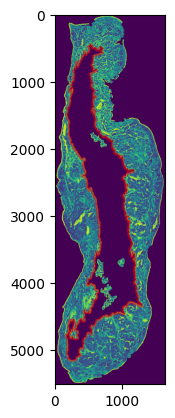

In [48]:
sec = find_second_largest_countour(image1_gray)
plt.imshow(image1_gray)
plt.plot(sec[:,:,0], sec[:,:,1], 'r', alpha = 0.5, label = 'Contour')

In [216]:
square1 = cv2.fillPoly(np.zeros(image1.shape), [squares[0].astype('int32')], color = (255, 255, 255))

In [273]:
np.logical_and(np.ones(image1.shape), square1).sum()

629409

In [274]:
np.logical_and(image1, square1).sum()

577620

In [245]:
square2 = cv2.fillPoly(np.zeros(image1.shape), [squares[100].astype('int32')], color = (255, 255, 255))

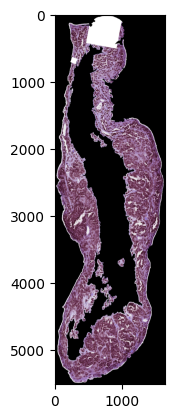

In [269]:
plt.imshow(np.where(np.logical_or(np.logical_and(image1, square1), square2), 255, image1))

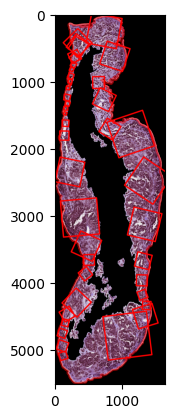

In [265]:
result_image, contour, squares = normal_squares_from_contour(
     image1,
     whole_thresh,
     square_size=256,
     step=5,
     overlap_thresh=0.1,
     smoothing_size=2
 )

Save to geopandas geodataframe:
- create pd dataframe
- columns: patient ID, top_left_x, top_left_y, bottom_right_x, bottom_right_y, classification
- convert to gpd.GeoDataFrame

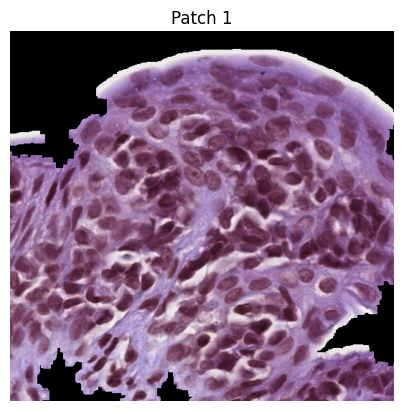

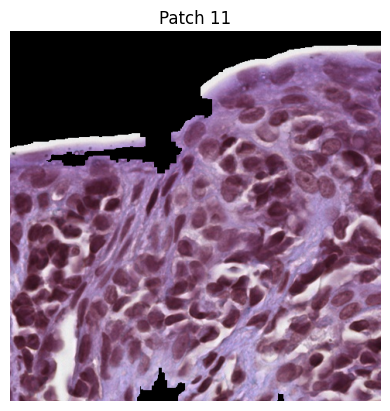

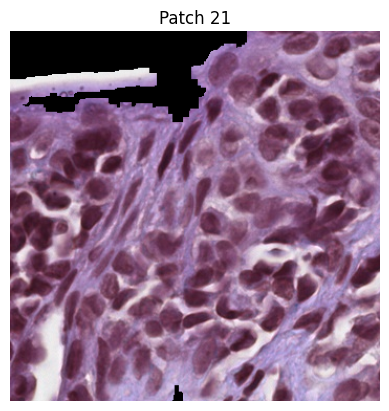

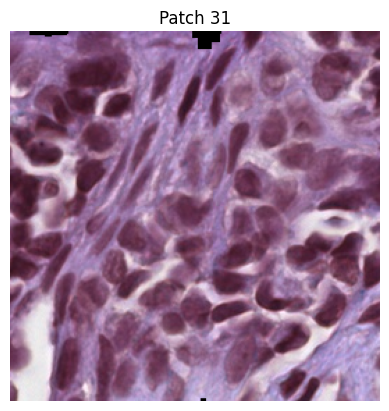

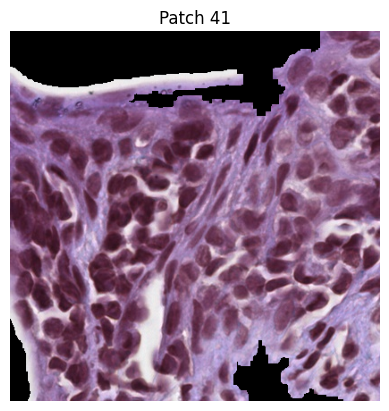

...

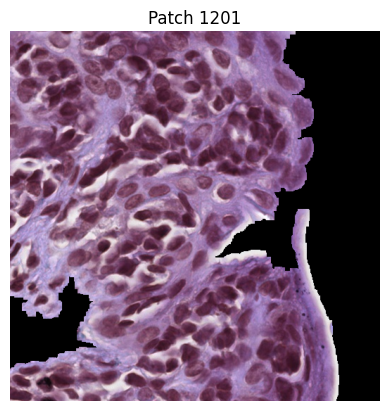

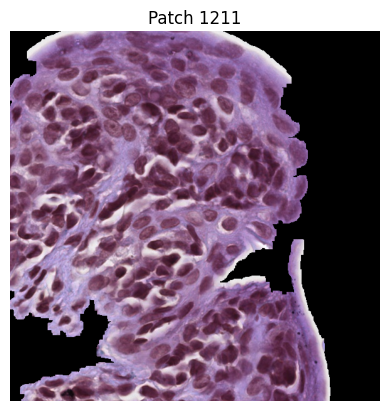

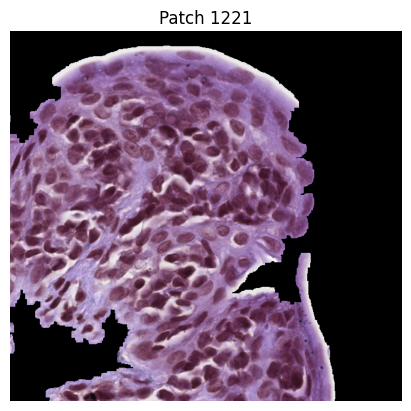

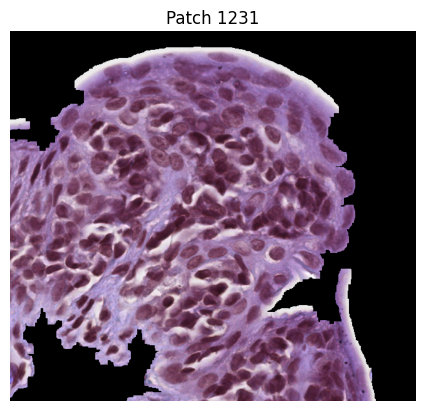

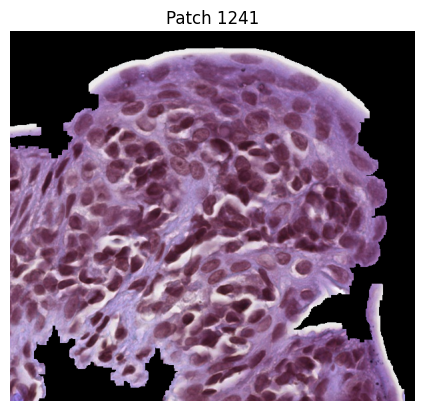

In [72]:
# Extract the image patches corresponding to the squares
patches = extract_square_images(image1, squares)

# Display or save the patches
for i, patch in enumerate(patches):
    if i % 10 == 0:
        plt.figure()
        plt.imshow(patch, cmap='gray')
        plt.title(f"Patch {i + 1}")
        plt.axis('off')
        plt.show()

### Below is a basic approach to thresholding and masking an image that still has its white background


```python
image1_gray = cv2.cvtColor(image1, cv2.COLOR_BGR2GRAY)
_,whole_thresh=cv2.threshold(image1_gray,200,255,cv2.THRESH_BINARY)#+cv2.THRESH_OTSU)
whole_thresh_inv=cv2.bitwise_not(whole_thresh)
whole_thresh=whole_thresh_inv
plt.imshow(whole_thresh_inv,cmap='gray')
```